# [E-12] 딥러닝으로 문자 읽기

### 목차 

1. 라이브러리 Import 
2. 데이터준비
3. Google - OCR
4. Keras - OCR
5. Tesseract - OCR
6. 비교
7. 테스트 결과 정리 


### 목표 

<br> 

|평가문항|상세기준|
|:---|:---|
|1. OCR을 활용하여 구현하려는 서비스의 기획이 타당한가? | 목표로 하는 서비스가 OCR를 적용 가능하며, OCR을 활용했을 때 더욱 유용해진다.|
|2. 모델 평가기준이 명확하고 체계적으로 세워졌는가? | 평가 기준에 부합하는 테스트 데이터의 특징이 무엇인지 명확하게 제시되었다.|
|3. 평가기준에 따라 충분한 분량의 테스트가 진행되고 그 결과가 잘 정리되었는가? | 최대 20장까지의 테스트 이미지를 사용해 제시된 평가 기준에 따른 테스트 결과가 잘 정리되어 결론이 도출되었다.|

<br>

### (1) 라이브러리 IMPORT 

In [1]:
import os
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.image as img
%matplotlib inline

import keras_ocr


import pytesseract
from PIL import Image
from pytesseract import Output

import warnings
warnings.filterwarnings("ignore")

import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import warnings
warnings.filterwarnings(action='ignore')

import urllib
import cv2 
from pixellib.semantic import semantic_segmentation 

### (2) 데이터준비

In [2]:
img_dir = '/aiffel/aiffel/ocr_python/tickets/'
tickets = os.listdir(img_dir)
tickets

['ticket10.jpg',
 'ticket2.jpg',
 'ticket6.jpg',
 'ticket8.jpg',
 'ticket7.jpg',
 'ticket4.jpg',
 'ticket1.jpg',
 'ticket3.jpg',
 'ticket9.jpg',
 'ticket5.jpg']

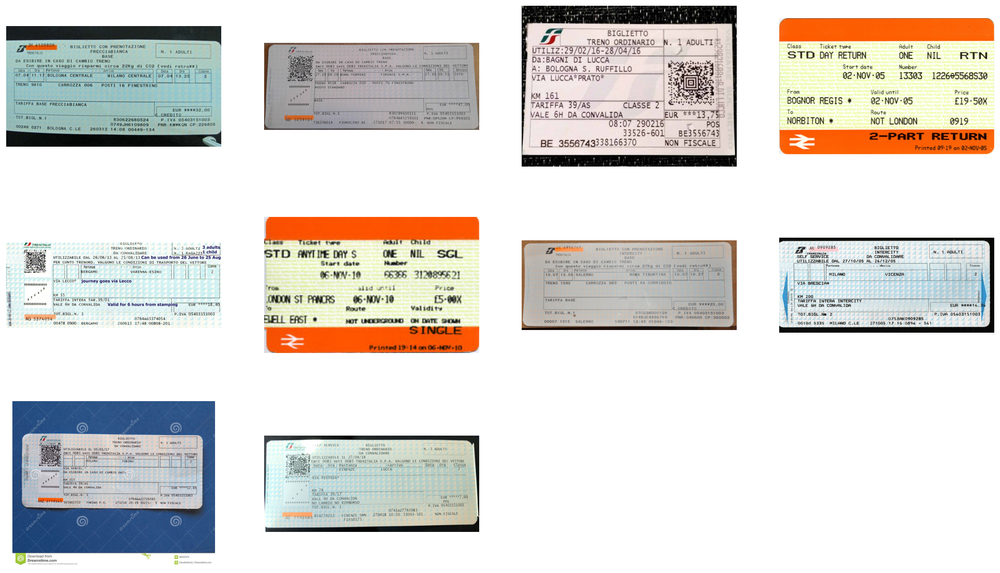

In [3]:
plt.figure(figsize=(20,20))

for idx, im in enumerate (tickets):
    im =  img_dir +'/'+ im
    plt.subplot(5, 4, idx+1)
    im = img.imread(im)
    plt.imshow(im)
    plt.axis('off')

### (3) Google-OCR

In [4]:
# Google-OCR
# 로컬 환경에서는 다운받은 인증키 경로가 정확하게 지정되어 있어야함 
!ls -l $GOOGLE_APPLICATION_CREDENTIALS

import os 

os.environ["GOOGLE_APPLICATION_CREDENTIALS"] =  os.getenv('HOME')+'/aiffel/ocr_python/my_google_api_key.json'

def detect_text(path):
    """Detects text in the file."""
    from google.cloud import vision
    import io
    client = vision.ImageAnnotatorClient()

    with io.open(path, 'rb') as image_file:
        content = image_file.read()
        
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations
    print('Texts:')

    for text in texts:
       print('\n"{}"'.format(text.description))

    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(
                response.error.message))

total 992
drwxr-xr-x 3 root root   4096 Apr 27 11:41 '~'
drwxr-xr-x 2 root root   4096 May 23 01:35  activation
drwxr-xr-x 3 root root   4096 Apr 26 03:42  bike_regression
drwxr-xr-x 5 root root   4096 May 26 12:12  camera_sticker
drwxr-xr-x 3 root root   4096 May 13 01:18  cats_vs_dogs
drwxr-xr-x 3 root root   4096 May 11 03:25  cat_vs_dog
drwxr-xr-x 2 root root   4096 Apr 22 08:51  data_preprocess
drwxr-xr-x 3 root root   4096 Apr 20 03:58  data_represent
drwxr-xr-x 2 root root   4096 Apr 22 02:06  data_visualization
-rw-r--r-- 1 root root 904651 Jun 16 14:04 '[E-12] READ_google (9).ipynb'
drwxr-xr-x 6 root root   4096 Jun 12 07:30  human_segmentation
drwxr-xr-x 2 root root   4096 Jun 10 01:53  information_theory
drwxr-xr-x 3 root root   4096 May  6 13:17  kaggle_kakr_housing
drwx------ 2 root root  16384 Apr 12 02:29  lost+found
drwxr-xr-x 4 root root   4096 May 19 13:23  lyricist
drwxr-xr-x 5 root root   4096 May 24 13:54  news_summarization
drwxr-xr-x 4 root root   4096 Jun 16 13:

[ticket10.jpg]


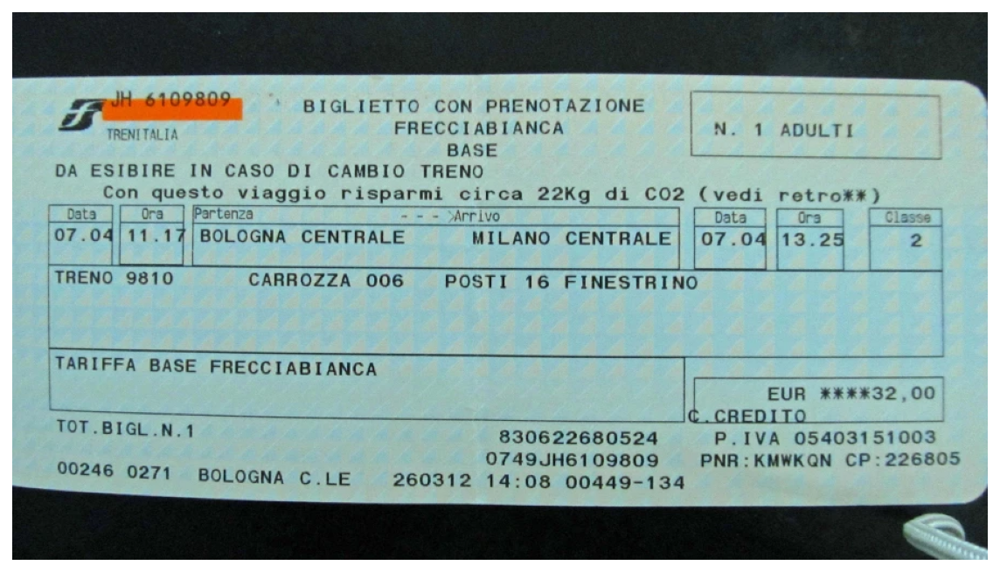

Texts:

"JH 6109809
BIGLIETTO CON PRENOTAZIONE
FRECCIABIANCA
BASE
N. 1 ADULTI
TRENITALIA
DA ESIBIRE IN CASO DI CAMBIO TRENO
Con questo viaggio risparmi circa 22Kg di CO2 (vedi retro**)
Data Ora Partenza
07.04 11.17 BOLOGNA CENTRALE
>Arrivo
Classe
--
Data
Ora
07.04 13.25
MILANO CENTRALE
2
TRENO 9810
CARROZZA 006
POSTI 16 FINESTRINO
TARIFFA BASE FRECCIABIANCA
EUR ****32,00
C. CREDITO
TOT.BIGL.N.1
830622680524
0749JH6109809
P. IVA 05403151003
PNR: KMWKQN CP: 226805
00246 0271 BOLOGNA C.LE 260312 14:08 00449-134"

"JH"

"6109809"

"BIGLIETTO"

"CON"

"PRENOTAZIONE"

"FRECCIABIANCA"

"BASE"

"N."

"1"

"ADULTI"

"TRENITALIA"

"DA"

"ESIBIRE"

"IN"

"CASO"

"DI"

"CAMBIO"

"TRENO"

"Con"

"questo"

"viaggio"

"risparmi"

"circa"

"22Kg"

"di"

"CO2"

"("

"vedi"

"retro"

"**"

")"

"Data"

"Ora"

"Partenza"

"07.04"

"11.17"

"BOLOGNA"

"CENTRALE"

">"

"Arrivo"

"Classe"

"--"

"Data"

"Ora"

"07.04"

"13.25"

"MILANO"

"CENTRALE"

"2"

"TRENO"

"9810"

"CARROZZA"

"006"

"POSTI"

"16"

"F

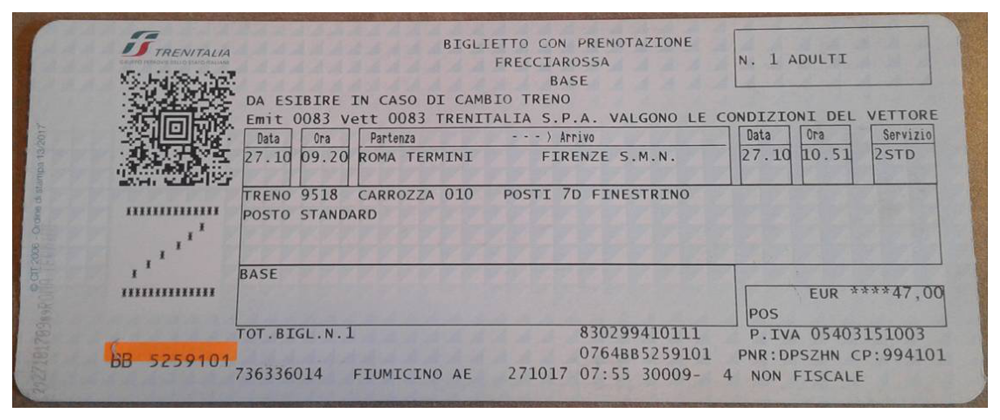

Texts:

"08686827872262
TRENITALIA
[IIIIII
*************
BB 5259101
BIGLIETTO CON PRENOTAZIONE
FRECCIAROSSA
BASE
N. 1 ADULTI
DA ESIBIRE IN CASO DI CAMBIO TRENO
Emit 0083 vett 0083 TRENITALIA S.P.A. VALGONO LE CONDIZIONI DEL VETTORE
Data Ora Partenza
27.10 09.20 ROMA TERMINI
---> Arrivo
Data Ora
27.10 10.51
Servizio
2STD
FIRENZE S.M.N.
POSTI 7D FINESTRINO
TRENO 9518 CARROZZA 010
POSTO STANDARD
BASE
EUR ****47,00
POS
TOT.BIGL.N.1
P.IVA 05403151003
830299410111
0764BB5259101
PNR: DPSZHN CP: 994101
736336014 FIUMICINO AE
271017 07:55 30009-
4 NON FISCALE"

"08686827872262"

"TRENITALIA"

"["

"IIIIII"

"*************"

"BB"

"5259101"

"BIGLIETTO"

"CON"

"PRENOTAZIONE"

"FRECCIAROSSA"

"BASE"

"N."

"1"

"ADULTI"

"DA"

"ESIBIRE"

"IN"

"CASO"

"DI"

"CAMBIO"

"TRENO"

"Emit"

"0083"

"vett"

"0083"

"TRENITALIA"

"S.P.A."

"VALGONO"

"LE"

"CONDIZIONI"

"DEL"

"VETTORE"

"Data"

"Ora"

"Partenza"

"27.10"

"09.20"

"ROMA"

"TERMINI"

"---"

">"

"Arrivo"

"Data"

"Ora"

"27.10"

"10.51"


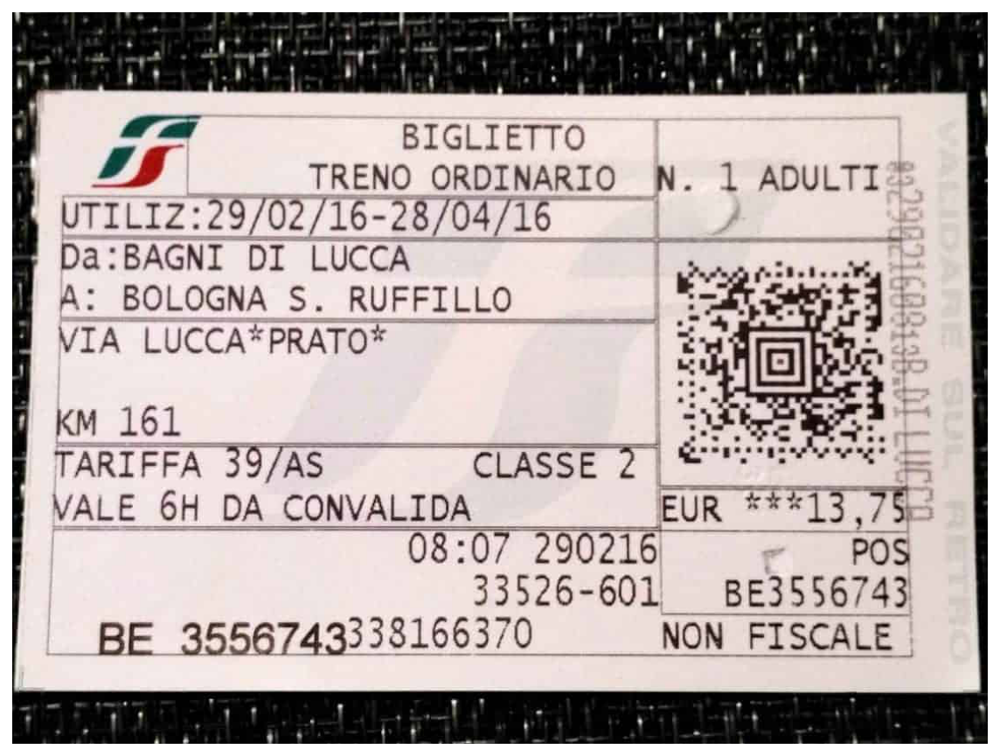

Texts:

"f
UTILIZ:29/02/16-28/04/16
Da: BAGNI DI LUCCA
1A: BOLOGNA S. RUFFILLO
VIA LUCCA PRATO*
KM 161
TARIFFA 39/AS
VALE 6H DA CONVALIDA
BIGLIETTO
TRENO ORDINARIO N. 1 ADULTI
CLASSE 2
08:07 290216
892902160813B.DI LUCCA
EUR ***13,75
POS
33526-601 BE3556743
NON FISCALE
BE 3556743338166370"

"f"

"UTILIZ"

":"

"29"

"/"

"02"

"/"

"16-28"

"/"

"04"

"/"

"16"

"Da"

":"

"BAGNI"

"DI"

"LUCCA"

"1A"

":"

"BOLOGNA"

"S."

"RUFFILLO"

"VIA"

"LUCCA"

"PRATO"

"*"

"KM"

"161"

"TARIFFA"

"39"

"/"

"AS"

"VALE"

"6H"

"DA"

"CONVALIDA"

"BIGLIETTO"

"TRENO"

"ORDINARIO"

"N."

"1"

"ADULTI"

"CLASSE"

"2"

"08:07"

"290216"

"892902160813B.DI"

"LUCCA"

"EUR"

"***"

"13,75"

"POS"

"33526-601"

"BE3556743"

"NON"

"FISCALE"

"BE"

"3556743338166370"

[ticket8.jpg]


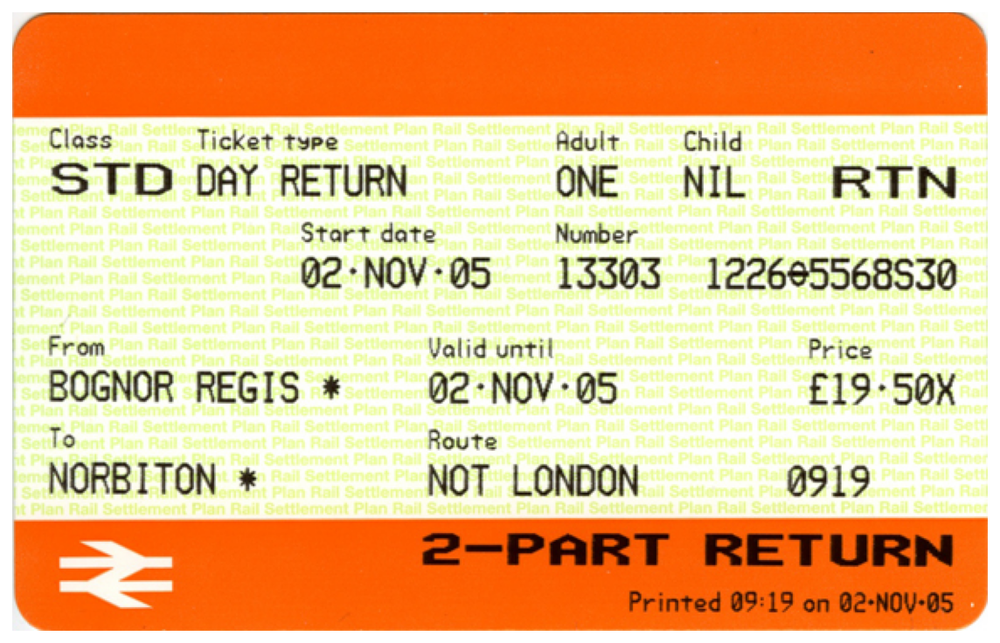

Texts:

"Settler
Plan Rail Settlement
Settlem
Class
Rail Settlement Plan Rail Setti
Ticket type Settlement Plan Rail Settic Adult
Ralls Child Plan Rail Settlement Plan Rail
at Pla
il Settlement Plan
Settlement P
STD DAY RETURN
Rail Settlement ONE
en Rail Settlement ONE: SettierNIL Rell SRTN
Setti
Plan
Plan Rail
t Plan Rail Settlement Plan Rail Settle
ement Plan Rail Settlement Plan Rail Start date Settlement Number
Rail Settlement Plan Rail Settlement Plan Rail Settlement Plan Rail Settlemen
ment Plan Rail Setti
Settlement Plan Rail Settlement Plan Rail
Plan
Settlement Plan Rail Settlement Plan
Plan Rail
t Plan Rail
Plan Rail Setti
ement Plan Rail Settlement Plan R02 NOV 05 13303 122605568930
Settlement Plan Rail Settlement Plan Hall
I Settlemen
Rail
t Plan Rail Settlement Plan Rail Settlement Plan Rail Settle
ent Plan Rail Settlement Plan Rail Settlement Plan Rail
ettlement Plan Rail Settlement Plan Rail
ail Settlement Plan Rail Settlement Plan Rail Settl
From Plan Rail Settlement Pla

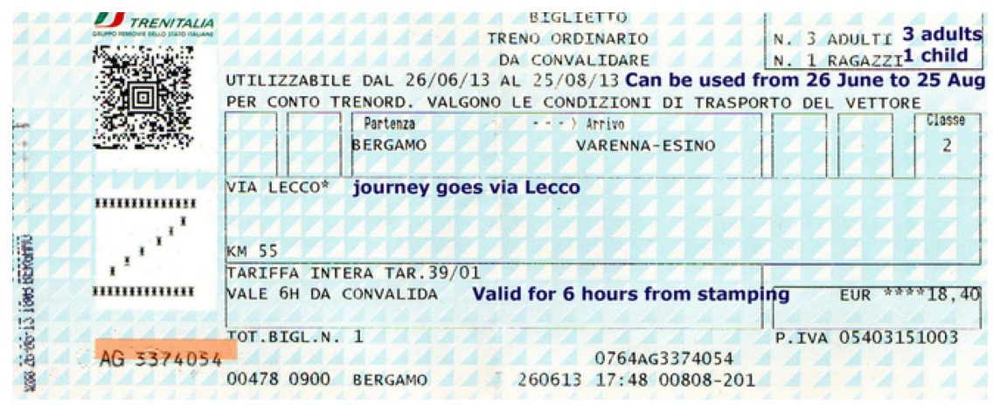

Texts:

"CART ST-00-27
TRENITALIA
GERE DELLO SADALAN
AG 3374054
BIGLIETTO
TRENO ORDINARIO
DA CONVALIDARE
N. 3 ADULTI 3 adults
N. 1 RAGAZZI1 child
UTILIZZABILE DAL 26/06/13 AL 25/08/13 Can be used from 26 June to 25 Aug
PER CONTO TRENORD. VALGONO LE CONDIZIONI DI TRASPORTO DEL VETTORE
Partenza
Arrivo
Classe
BERGAMO
144447
VARENNA-ESINO
2
VIA LECCO journey goes via Lecco
KM 55
TARIFFA INTERA TAR. 39/01
VALE 6H DA CONVALIDA Valid for 6 hours from stamping EUR 18, 40
TOT.BIGL.N. 1
P. IVA 05403151003
0764AG3374054
00478 0900 BERGAMO
260613 17:48 00808-201
ALL
AAA
AAAA
AAAN"

"CART"

"ST"

"-"

"00-27"

"TRENITALIA"

"GERE"

"DELLO"

"SADALAN"

"AG"

"3374054"

"BIGLIETTO"

"TRENO"

"ORDINARIO"

"DA"

"CONVALIDARE"

"N."

"3"

"ADULTI"

"3"

"adults"

"N."

"1"

"RAGAZZI1"

"child"

"UTILIZZABILE"

"DAL"

"26/06/13"

"AL"

"25/08/13"

"Can"

"be"

"used"

"from"

"26"

"June"

"to"

"25"

"Aug"

"PER"

"CONTO"

"TRENORD"

"."

"VALGONO"

"LE"

"CONDIZIONI"

"DI"

"TRASPORTO"

"DEL"

"VETTORE

In [5]:
for idx, ticket in enumerate(tickets):
    if idx < 5:
        print(f'[{ticket}]')
        plt.figure(figsize=(10,10))
        plt.imshow(img.imread(img_dir+'/'+ticket))
        plt.axis('off')
        plt.show()
        detect_text(os.path.join(img_dir, ticket))
        print()

### (4) Keras ocr


In [6]:
pipeline = keras_ocr.pipeline.Pipeline()

images = [keras_ocr.tools.read(os.path.join(img_dir, ticket)) for ticket in tickets]
prediction_groups = [pipeline.recognize([os.path.join(img_dir, ticket)]) for ticket in tickets]


Looking for /aiffel/.keras-ocr/craft_mlt_25k.h5
Looking for /aiffel/.keras-ocr/crnn_kurapan.h5


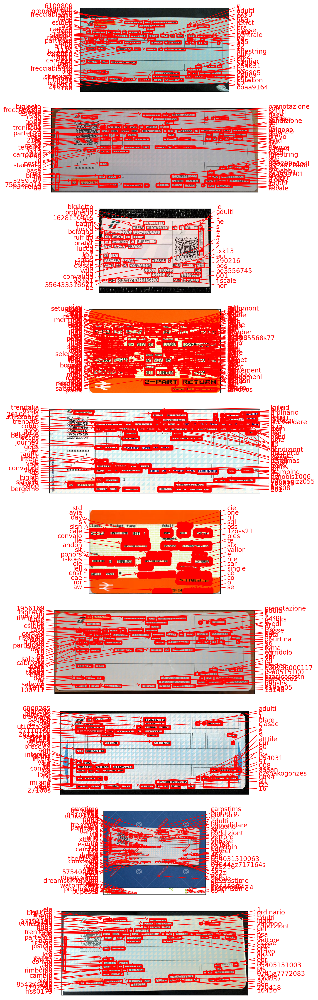

In [7]:
fig, axs = plt.subplots(nrows=10, figsize=(40, 40))
for idx, ax in enumerate(axs):
    if idx <10:
        keras_ocr.tools.drawAnnotations(image=images[idx], 
                                        predictions=prediction_groups[idx][0], ax=ax)

### (5) tesseract ocr

In [8]:
def recognize_images(image_path='./images/sample.png', output_path='./sample'):
    if not os.path.exists(output_path):
        os.mkdir(output_path)
    custom_oem_psm_config = r'--oem 3 --psm 3'
    image = Image.open(image_path)

    recognized_data = pytesseract.image_to_data(
        image, lang='eng',    # 한국어라면 lang='kor'
        config=custom_oem_psm_config,
        output_type=Output.DICT
    )
    
    top_level = max(recognized_data['level'])
    index = 0
    cropped_image_path_list = []
    for i in range(len(recognized_data['level'])):
        level = recognized_data['level'][i]
    
        if level == top_level:
            left = recognized_data['left'][i]
            top = recognized_data['top'][i]
            width = recognized_data['width'][i]
            height = recognized_data['height'][i]
            
            output_img_path = os.path.join(output_path, f"{str(index).zfill(4)}.png")

            cropped_image = image.crop((
                left,
                top,
                left+width,
                top+height
            ))
            cropped_image.save(output_img_path)
            cropped_image_path_list.append(output_img_path)
            index += 1

    custom_oem_psm_config = r'--oem 3 --psm 7'
    
    for image_path in cropped_image_path_list:
        image = Image.open(image_path)
        recognized_data = pytesseract.image_to_string(
            image, lang='eng',    # 한국어라면 lang='kor'
            config=custom_oem_psm_config,
            output_type=Output.DICT
        )
        print(recognized_data['text'])
    print('================================================\n')

[ticket10.jpg]


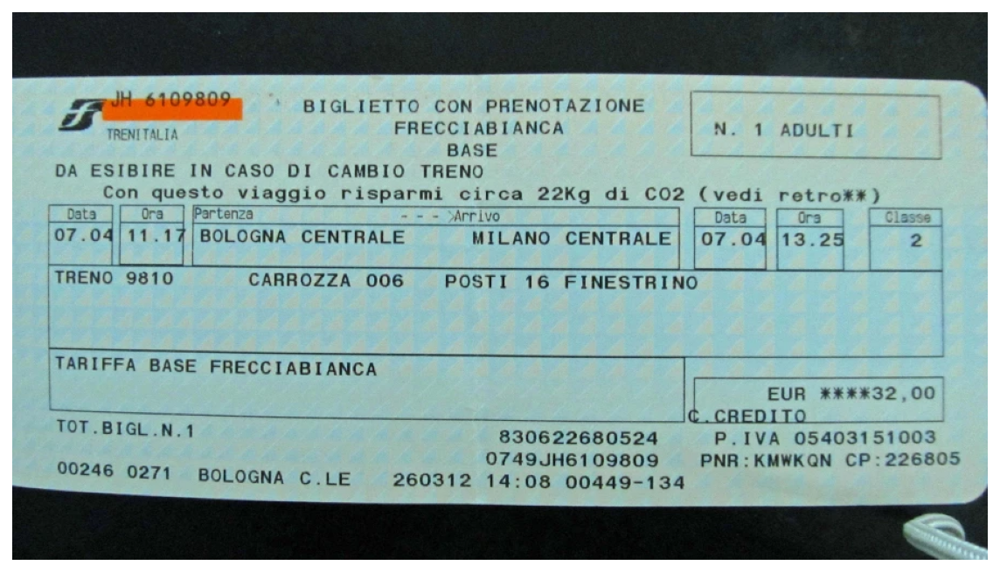

i(5l [retiiQ

(ON

MHIENOT AS | ONE

rHECUILABILANCA

:

NI

7

ARUULT f

AS bE

|

ay:

FSi BRiRE

iN

CASO

uw

LL AMBIT UO

TRENO

Con

questo

Viaggio

risparml

Cir Ce

22g

oi

CLO

pecs

retro#* )

——

3

| Partenza

rive

oe?

|

07.04|11.17%| BOLOGNA CEI

CENTRALE

MILANO

CENTRALE

07

y



|

|

TRENO

45 7 ()

L_AHRROZZA

OO

CST]

16

r-IiN-ES | HINO

pte

| |

Dat

iy iva

|_Data

tra

ee


1ARILFFA

SASE

FRECCIABIANCA


ON a luk

4

Pe Li be

eee a? OU

—— eee ioet—t

FF.

¢ CREDITO

1OT

SiGL .N. 7

830622680524

2 iFVA

05403151003

O/49JH61098B09

Nr

a MWR ON

Ce

2A68U5

260312

14:08

O0449-134

JO246

0271

BOLOGNA

YL. LE

.


[ticket2.jpg]


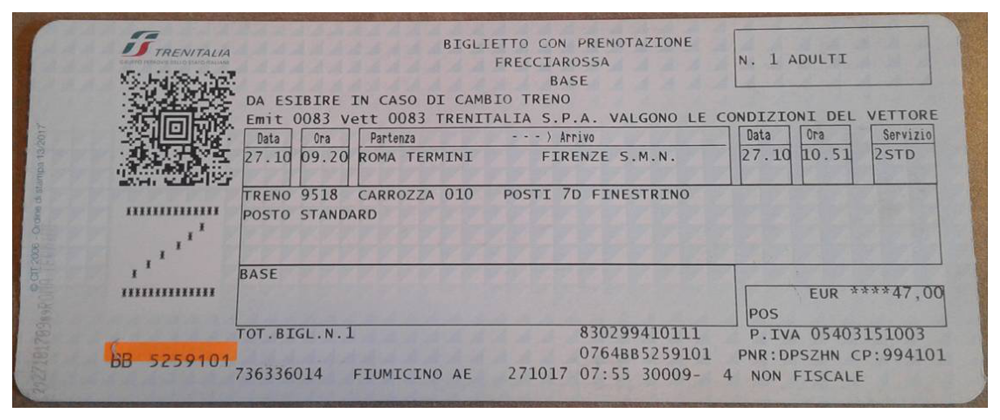

e


IB vss

IVS FAL Ia

BIGLIEFEITIQ

YT iON

PRENOTAY LONE

FRECCIAROSSA

NN.

L

ADULT 1

i

>

RASE

be

ey.

FS TRIKE

LN

( AS©O

DT

( AMB ILO)

TRENO

Emit

OO 3

VetTtt

O08 3

TRENITLTALIA

S.P.A.

VALGONO

|

CONDIZIONL

DOEL

VETLI ORE

Data

ora

Servizio

Data

Ora

Partenza

————

- )

ATT LVO

Pf

1O.51

STD

ioeg eee

emit 0063 vett_ 0083 TRENITALTA S.P-A- VALCON® UE CN EO ena

pe Ce | Bee ee

|

|

|

|

)

|

2/.1Q

Q /}

ROMA

TERMINI

-iTREN/E

S . M.N.

|

|

|

|

aad Se SRR OI To eres tt

A

TRENO

9518

( AKKO//A

Ol

MOST I

/D

-¥INESITRINO

POST O

STANDARD


ASE Fete eee eee a

PESTLE See eTTE

re lik

7

POS

TOT.BIGL.N.1

$30299410111

w TVA

05403151003

O/64BB5259101

PNK: DPS/ZHN

CP:9S94101

2/101/

QO/:55

$O009-

4A

NOWN

rFISCALE


|

|

736336014

rFITUMILC INO

At



[ticket6.jpg]


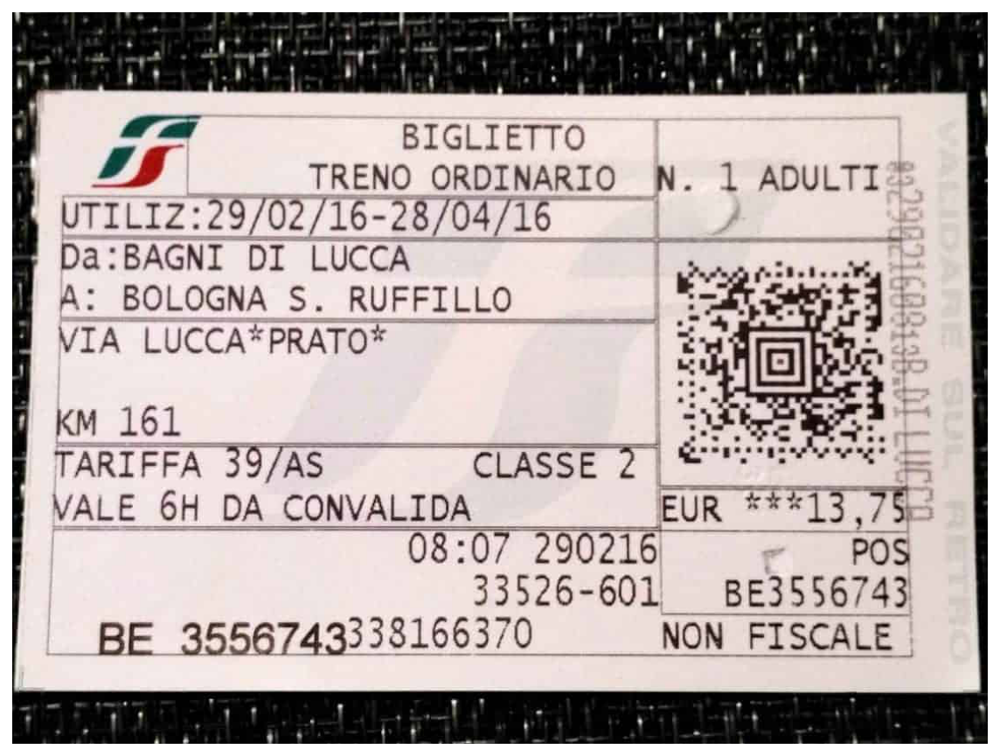

SIGLITETTO

TRENO

ORDINARIO

UTILIZ:

29/02/16-28/04/16

Da“ BAGNI

YT

| UCCA

A’

BOLOGNA

ao

RUFF ITLL O

VIA

|. UCCA* PRATO*

K MV]

161

Neen

TARTFFA

39/AS

VALE

by |

DA

CONVALIDY


O08:

BE3556/43

NON

FISCALE

=




In [9]:
save_dir = os.getenv('HOME')+'/aiffel/ocr_python/tickets/'

for idx, ticket in enumerate(tickets):
    if idx <3:
        print(f'[{ticket}]')
        plt.figure(figsize=(10,10))
        plt.imshow(img.imread(img_dir+'/'+ticket))
        plt.axis('off')
        plt.show()
        try:
            recognize_images(os.path.join(img_dir, ticket), save_dir)
        except:
            print(f'Cannot recognize characters from {ticket}')

### (6) 비교 

In [10]:
def compare_ocr(ticket):
    print('[keras-ocr]')
    idx = tickets.index(ticket)
    keras_ocr.tools.drawAnnotations(image=images[idx], predictions=prediction_groups[idx][0])
    plt.show()
    print('================================================\n')
    print('[Tesseract]')
    try:
        recognize_images(os.path.join(img_dir, ticket), save_dir)
    except:
        print(f'Cannot recognize characters from {ticket}')


    print('================================================\n')
    print('[Google]')
    detect_text(os.path.join(img_dir, ticket))
    print('================================================\n')

[keras-ocr]


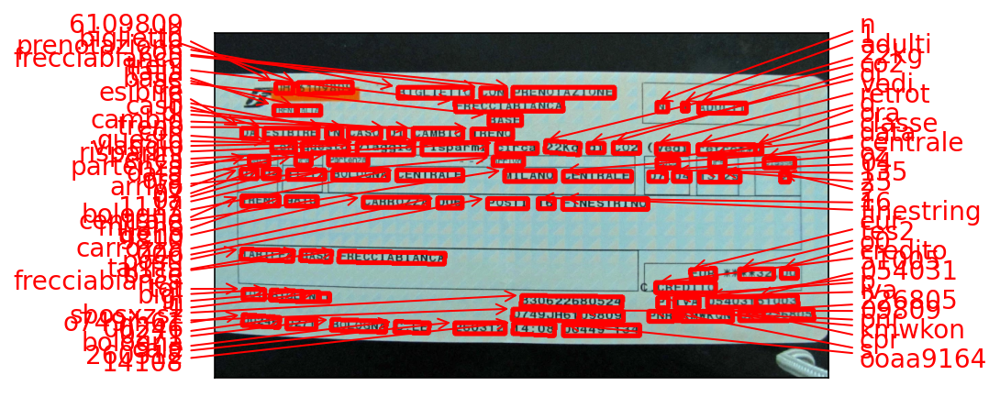


[Tesseract]
i(5l [retiiQ

(ON

MHIENOT AS | ONE

rHECUILABILANCA

:

NI

7

ARUULT f

AS bE

|

ay:

FSi BRiRE

iN

CASO

uw

LL AMBIT UO

TRENO

Con

questo

Viaggio

risparml

Cir Ce

22g

oi

CLO

pecs

retro#* )

——

3

| Partenza

rive

oe?

|

07.04|11.17%| BOLOGNA CEI

CENTRALE

MILANO

CENTRALE

07

y



|

|

TRENO

45 7 ()

L_AHRROZZA

OO

CST]

16

r-IiN-ES | HINO

pte

| |

Dat

iy iva

|_Data

tra

ee


1ARILFFA

SASE

FRECCIABIANCA


ON a luk

4

Pe Li be

eee a? OU

—— eee ioet—t

FF.

¢ CREDITO

1OT

SiGL .N. 7

830622680524

2 iFVA

05403151003

O/49JH61098B09

Nr

a MWR ON

Ce

2A68U5

260312

14:08

O0449-134

JO246

0271

BOLOGNA

YL. LE

.



[Google]
Texts:

"JH 6109809
BIGLIETTO CON PRENOTAZIONE
FRECCIABIANCA
BASE
N. 1 ADULTI
TRENITALIA
DA ESIBIRE IN CASO DI CAMBIO TRENO
Con questo viaggio risparmi circa 22Kg di CO2 (vedi retro**)
Data Ora Partenza
07.04 11.17 BOLOGNA CENTRALE

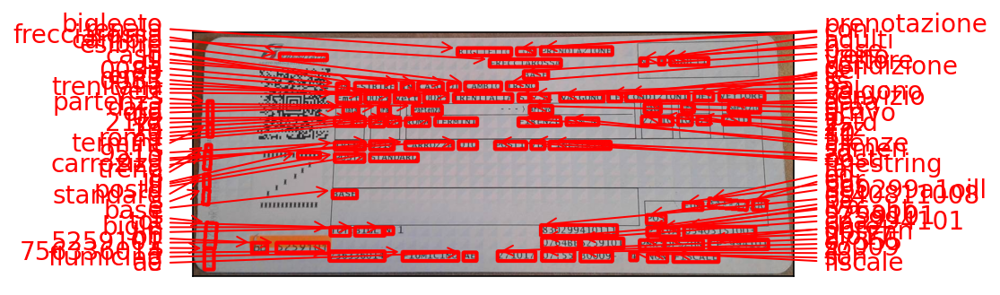


[Tesseract]
e


IB vss

IVS FAL Ia

BIGLIEFEITIQ

YT iON

PRENOTAY LONE

FRECCIAROSSA

NN.

L

ADULT 1

i

>

RASE

be

ey.

FS TRIKE

LN

( AS©O

DT

( AMB ILO)

TRENO

Emit

OO 3

VetTtt

O08 3

TRENITLTALIA

S.P.A.

VALGONO

|

CONDIZIONL

DOEL

VETLI ORE

Data

ora

Servizio

Data

Ora

Partenza

————

- )

ATT LVO

Pf

1O.51

STD

ioeg eee

emit 0063 vett_ 0083 TRENITALTA S.P-A- VALCON® UE CN EO ena

pe Ce | Bee ee

|

|

|

|

)

|

2/.1Q

Q /}

ROMA

TERMINI

-iTREN/E

S . M.N.

|

|

|

|

aad Se SRR OI To eres tt

A

TRENO

9518

( AKKO//A

Ol

MOST I

/D

-¥INESITRINO

POST O

STANDARD


ASE Fete eee eee a

PESTLE See eTTE

re lik

7

POS

TOT.BIGL.N.1

$30299410111

w TVA

05403151003

O/64BB5259101

PNK: DPS/ZHN

CP:9S94101

2/101/

QO/:55

$O009-

4A

NOWN

rFISCALE


|

|

736336014

rFITUMILC INO

At




[Google]
Texts:

"08686827872262
TRENITALIA
[IIIIII
*************
B

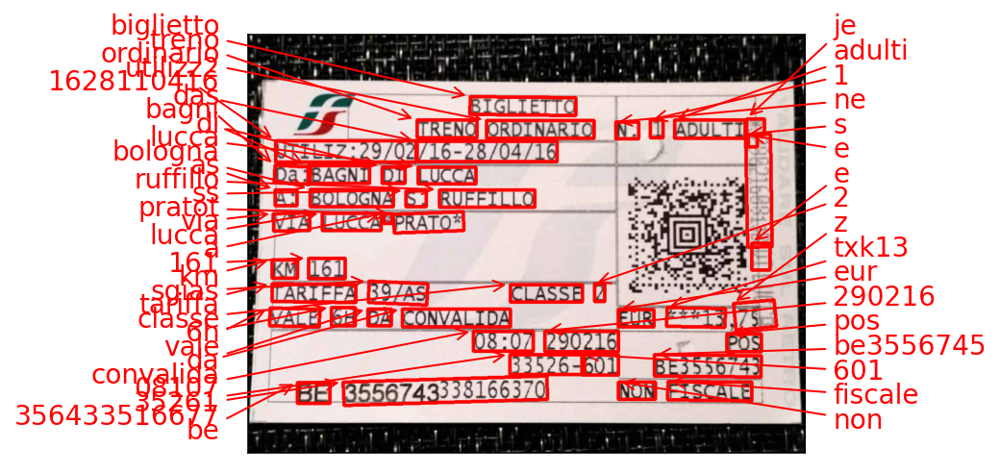


[Tesseract]
SIGLITETTO

TRENO

ORDINARIO

UTILIZ:

29/02/16-28/04/16

Da“ BAGNI

YT

| UCCA

A’

BOLOGNA

ao

RUFF ITLL O

VIA

|. UCCA* PRATO*

K MV]

161

Neen

TARTFFA

39/AS

VALE

by |

DA

CONVALIDY


O08:

BE3556/43

NON

FISCALE

=



[Google]
Texts:

"f
UTILIZ:29/02/16-28/04/16
Da: BAGNI DI LUCCA
1A: BOLOGNA S. RUFFILLO
VIA LUCCA PRATO*
KM 161
TARIFFA 39/AS
VALE 6H DA CONVALIDA
BIGLIETTO
TRENO ORDINARIO N. 1 ADULTI
CLASSE 2
08:07 290216
892902160813B.DI LUCCA
EUR ***13,75
POS
33526-601 BE3556743
NON FISCALE
BE 3556743338166370"

"f"

"UTILIZ"

":"

"29"

"/"

"02"

"/"

"16-28"

"/"

"04"

"/"

"16"

"Da"

":"

"BAGNI"

"DI"

"LUCCA"

"1A"

":"

"BOLOGNA"

"S."

"RUFFILLO"

"VIA"

"LUCCA"

"PRATO"

"*"

"KM"

"161"

"TARIFFA"

"39"

"/"

"AS"

"VALE"

"6H"

"DA"

"CONVALIDA"

"BIGLIETTO"

"TRENO"

"ORDINARIO"

"N."

"1"

"ADULTI"

"CLASSE"

"2"

"08:07"

"290216"

"892902160813B.DI"

"LUCCA"

"EUR"

"***"

"13,75"

"POS"

"33526-601"

"BE3556743"


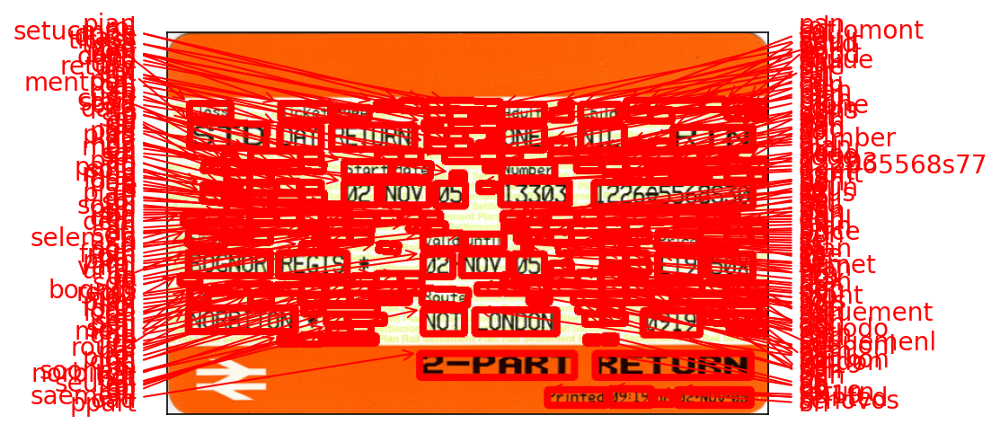


[Tesseract]
Class

licket

Ty¥Pe

S it}

DAT

RET LIRN

Adult

i hHild

ONE

NIL

mein

Start

date

Number

Vie > NOV -W5

15.505

12°695568S30

rrom

RONOR

REGIS

*

io

NORBI TON

*

Valid

uNnTTi

Price

Q2-NOV- OS

t 19°SUX

Route

NOT

| ONDON

WSLS


RE TURN

Printed

49:15

OT?

Bc*NOY-85



[Google]
Texts:

"Settler
Plan Rail Settlement
Settlem
Class
Rail Settlement Plan Rail Setti
Ticket type Settlement Plan Rail Settic Adult
Ralls Child Plan Rail Settlement Plan Rail
at Pla
il Settlement Plan
Settlement P
STD DAY RETURN
Rail Settlement ONE
en Rail Settlement ONE: SettierNIL Rell SRTN
Setti
Plan
Plan Rail
t Plan Rail Settlement Plan Rail Settle
ement Plan Rail Settlement Plan Rail Start date Settlement Number
Rail Settlement Plan Rail Settlement Plan Rail Settlement Plan Rail Settlemen
ment Plan Rail Setti
Settlement Plan Rail Settlement Plan Rail
Plan
Settlement Plan Rail Settlement Plan
Plan Rail
t Plan Rail
Plan Rail Setti
ement Pla

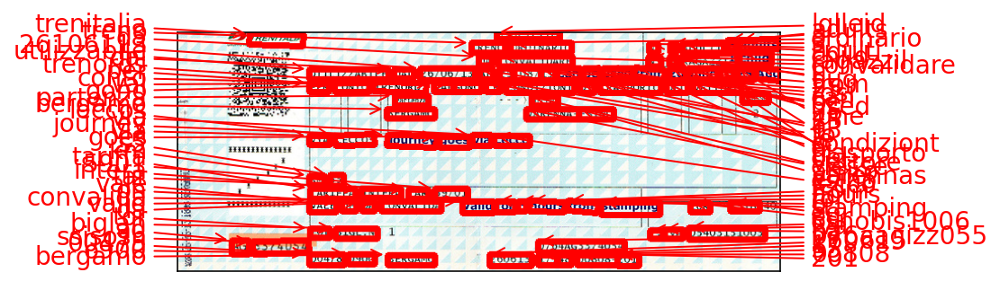


[Tesseract]
PP TRENITALIA

: .

ayn

oer

TREND

ORODELNAR LO

iF

5

ADULT I

3

aduit

ee

_UONVAL LUARE

N .

I

PACAT? TL

chiid

UlrILIZ7ABILE

DAL

26/06/13

AL

25/08/13

Can

De

used

from

26

june

to

25

Aug

veh

CONTO TRENORD. VALGONO

Le

CONDIZIONI |

[yy

Ss

VEL

VET TORE

Seem

===) priv


re ri

J

| Partenza

arriya

vee

le ar


| Lasse |


fees

VARENNA-ESINO


|

4

2

|

ie

LECCO”™

journey

YOes

Via

Lecco

.

ii


KM 55


AK] ee A

INTERA

TAR.

39/01

ALF

HH

ar

C( ONVAL ITLDA

Valid

for


nours

from

stamping

ruk

-

OF BIGL.N.

i

A

IVA

OS403 15 1004

)/64AG633/4054

UO4 sR

OOOO)

BEM GAY

60613

1|/:48

OOS0S-701



[Google]
Texts:

"CART ST-00-27
TRENITALIA
GERE DELLO SADALAN
AG 3374054
BIGLIETTO
TRENO ORDINARIO
DA CONVALIDARE
N. 3 ADULTI 3 adults
N. 1 RAGAZZI1 child
UTILIZZABILE DAL 26/06/13 AL 25/08/13 Can be used from 26 June to 25 Aug
PER CONT

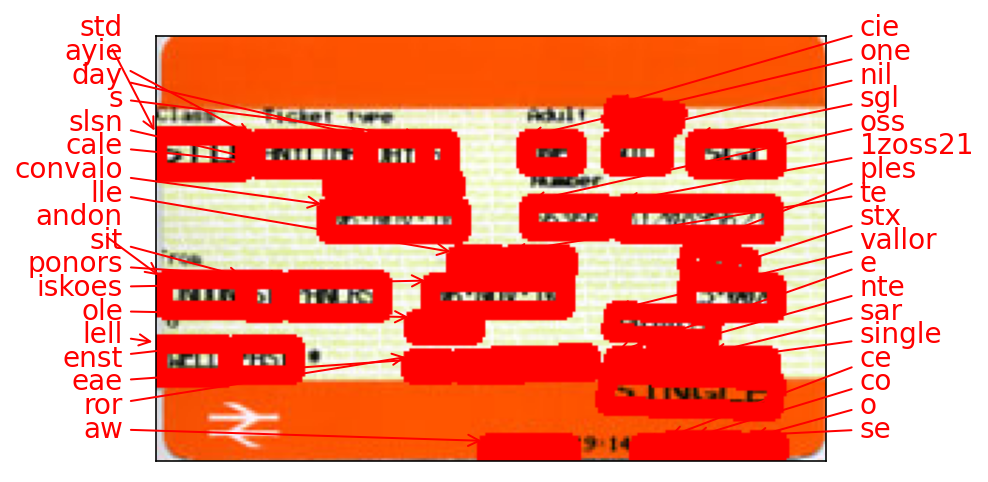


[Tesseract]
STL

rT

oni §

ta

Nil

SC

val

me NA 18

aS

MEE

cs

SI

PARES

_ We: FWe

vet iets

S51 EACT ¢

— i NGI -

rr tres ba" 5S or



[Google]
Texts:

"Ticket twe
STD ANYTIME DAY S
Start date
06-NOV-10
from
ONDON ST PANCRS
ELELL EAST.
1:
Adult Child
ONE NIL SGL
Humber
66366 3120895621
alid until
Price
06-NOV-10
£5-00X
Route
Validity
NOT UNDERGROUND ON DATE SHOWN
SINGLE
Printed 19-14 on 06-NOV-10"

"Ticket"

"twe"

"STD"

"ANYTIME"

"DAY"

"S"

"Start"

"date"

"06"

"-"

"NOV"

"-"

"10"

"from"

"ONDON"

"ST"

"PANCRS"

"ELELL"

"EAST"

"."

"1"

":"

"Adult"

"Child"

"ONE"

"NIL"

"SGL"

"Humber"

"66366"

"3120895621"

"alid"

"until"

"Price"

"06"

"-"

"NOV"

"-"

"10"

"£"

"5-00X"

"Route"

"Validity"

"NOT"

"UNDERGROUND"

"ON"

"DATE"

"SHOWN"

"SINGLE"

"Printed"

"19-14"

"on"

"06"

"-"

"NOV"

"-"

"10"

[keras-ocr]


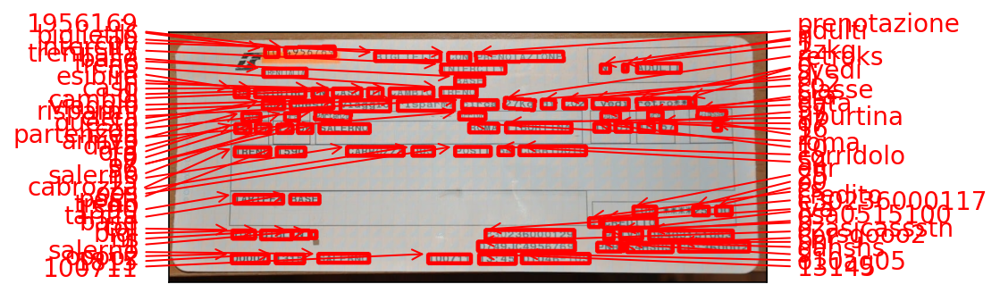


[Tesseract]

oe ifsi | | FG)

iMPrNIT TAL LA

1A

TR RE

iN

CASO

PT

CL AMG!

Lon

questo

viaggio

rispar

eMOTAZ | ONE

B®

se

7

ADULT!

Hele


————————— ee

ee ee =e ae erg Gf {ve one se

_Data

Ors

Parte

PAVe




pate | | Ore Pervenze

1O Of

-ER




HOMA

TIL BURT INA

TOCAIN «4fcaOn PADONITTA NN pneTYT GA eee

TRENO

1590

(AHROZZA

oie’

=16)-3 |

5

(COHRLUDOLG

pe

TARIFFA

BASE

Po - ehiet NF

<a

OOOO /

TS1TS

SAL EHNO

1OoOos717

| | | E i | | | = 7 2


eat

EUR

EUR ¥*#*##25.00.

l¢ CREDITO


MY IVA

05403151003

Nba

G4HSH5

Cr: 360007

r

19360001 39

U/494 JC aAV Sb / bY

i343 * 4%

OTO46~- 1045



[Google]
Texts:

"JC 4956769
BIGLIETTO CON PRENOTAZIONE
f
N. 1 ADULTI
TRENITALIA
INTERCITY
BASE
DA ESIBIRE IN CASO DI CAMBIO TRENO
Con questo viaggio risparmi
Ora Partenza
circa 27Kg di C02 (vedi retro**)
Data
Ora
Arrivo
Classe
Data
10.07 13.56
SALERNO
ROMA TIBURTINA 10.07 16.57
2
TRENO 1590
CARROZ

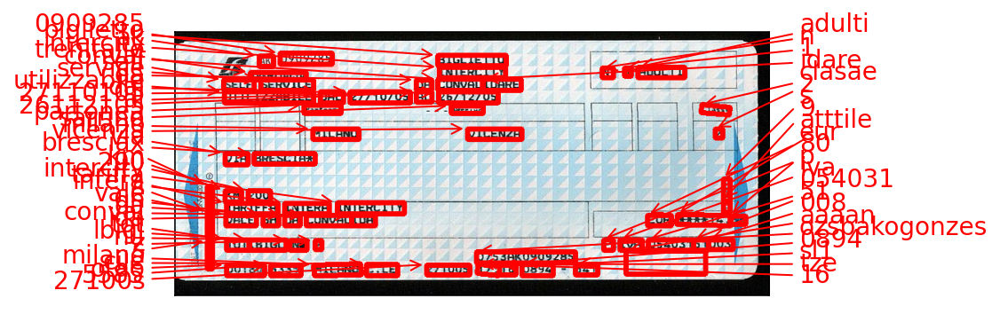


[Tesseract]
SAS TO Na a SEE eS aeRO S TE Sse n ees TOE Ne OE ena Seat Re ORR Re Ped ESD Sa EPS NN PRN TE FINE rE UNL EEE Yorn BP EO REM ESTES Om


|

|

|

|

3 ag 00180 5335 MILANO C.LE

' -z


— Me es Ae ee BR 8 eee

eae Ft

|

— Ol TO CC Ell El lr

wo Sy fw ss 2

ui

AK

USOU9S285

BIGLIETTO

INTERCITY


NO

7

Milt i i

Ts

eH DUTCE

ie

CONVAL

lLUARE

CS

ViILIZZABILLE

UAL

27/10/05

i

26/12/05


-

(> =) a eae

4 £4 A

Pe epeeeEEe f na

| le ee

a el


— © ieee eee tlCUmelttltlC(<iwa Ct‘

a i a a ee eae ta eee LL LLL LL

a “INTER

 _ a

|

|

"MTLANC

VIA

BRESC IAS

t2.

>


a

NIERL ITY

da

VALE

5h

OA

CUONVAL | UFR

¢é

ER eee

TOT .BIGL _Ne

9

P.IVA

05402151002

O7S3AK09039S285

2771005

17:76

O894

>a

S41

-_-> fe & =e

OUT atU

53435

MIilL ANG}

CLE

saat



[Google]
Texts:

"CONVALIDA
OCT 1996-Ord. n. 20 del 05-05
AMMA
AK 0909285
BIGLIETTO
INTERCITY
DA CONVALIDARE
TRENITALIA
SELF SER

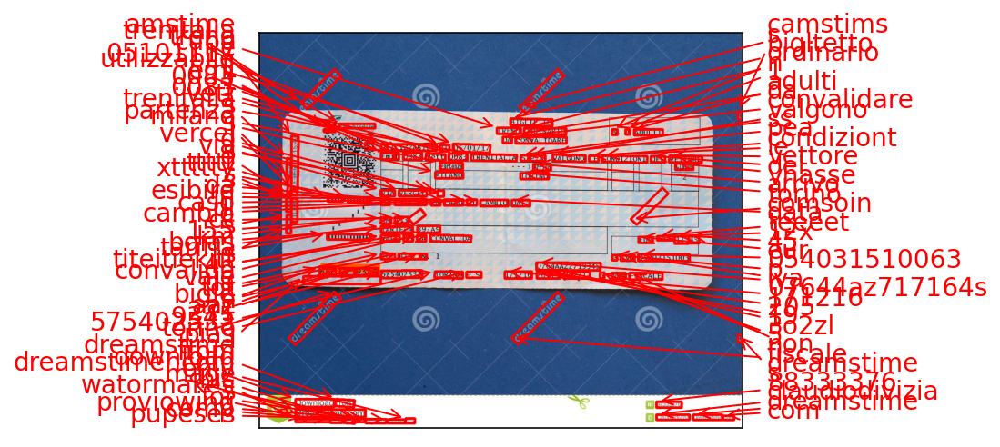


[Tesseract]
ee

NA

G

OQ

a

PA

B5IGLIETTO

TRENO

ORDINAR TO

N.

Ll

ADULTI

HA

C ONVAL IDARE

UTILIZZABILE

IL

05/01/17

ay

Fmit

0083

Vett

0083

TRENITALIA

S.P.A.

VAL GONG

ire

CONDIZTONT

ei

VETTORE

i

ae)

vartenza

== =}

ATT V¥O

TORINO


ies


=

EET EXEE

ALE

AH

DA

C ONVAL IDA

OT.BIGL.N.

LVA

RAZ

2719345 :

0764AAZ2719345

25402533

TORINO

YP Ss.

1/1716

20:19

30771-

5

NON

r-iSCAL E

Download

from

Dreamstime.com

auoIOdIVIzTIA

)

reamstime.com

oa Z -



[Google]
Texts:

"dreamstime
O MILANG COFFE17-15:42
TRENITALIA
BIGLIETTO
TRENO ORDINARIO
DA CONVALIDARE
GRUPPO FERROVIE DELLO STATO ITALIANE
"lat"
N. 1 ADULTI
UTILIZZABILE IL 05/01/17
Emit 0083 vett 0083 TRENITALIA S.P.A. VALGONO LE CONDIZIONI DEL VETTORE
Classe
Partenza
---> Arrivo
TORINO
MILANO
2
VIA VERCEL.
**************
DA ESIBIRE IN CASO DI CAMBIO DATA
KM 153
TARIFFA 39/AS
************** VALE 4H DA CONVALIDA
TOT.BIGL. N. 1
AAZ 2

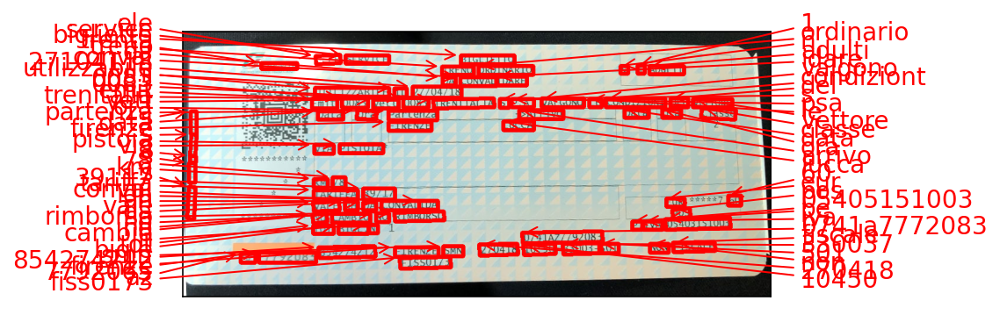


[Tesseract]
StkKYVY IC -

ait,t IFT iO

TRENO

ORDINAR LO

Ni.

1

ADUL IL

HA

( ONVAL | DAKE

UTiLiS/ABILE

|

2//Q4/18

_

aiinee

OOS 3

YVeTtT

OO 3

TRENLITALIA

S PA.

VALGONO

LE

CONDILZLONTE

DEL

VEIL TORE

;

Data

Ora

Flemzc

SS

nami

Data

Ora

Classe

ViA

PTSTOTA*

AV;

(/o_


es

=

be

TARIFFA

29/17

— lc ;!”tC”~”~”~”~”~”~”~”C”

i a

VAI F

4H

yA

(ONVAL LDA

ri

Re /

60,

NOU

( AMBLU

Nit}

RIMBORSO

— ll

POS

—

61

»Y TVA

05403151003

TOT. BIGL.N.

1

0741A7/7792083

ee

IIO9NR=

R54) /4) 17

-TREN/ZE

Ss IVE

270418

LO: 50

3$3003-S0L

NON

rT SCALE

FTISSOL/3

. | <i



[Google]
Texts:

"f
SELF SERVICE
TRENITA
GOVELLO STATO
BIGLIETTO
TRENO ORDINARIO
DA CONVALIDARE
444
N. 1 ADULTI
44
UTILIZZABILE IL 27/04/18
Emit 0083 Vett 0083 TRENITALIA S.P.A. VALGONO LE CONDIZIONI DEL VETTORE
O
Data Ora
Partenza
->Arrivo
Data Ora
Classe
FIRENZE
LUCCA
VIA PISTOIA*
北讀****資設資資
#
KM 78
TARIFFA 39

In [11]:
for ticket in tickets:
    compare_ocr(ticket)

### (7) 테스트 결과 정리 


|Google OCR |Keras OCR | Tesseract OCR |
|:---|:---|:---|
|![1](https://raw.githubusercontent.com/babababas/exploration/main/ticket13.jpg)  | ![2](https://raw.githubusercontent.com/babababas/exploration/503e6698a809d69b58b683220ac0d572b119ea26/ticket11.jpg)| ![3](https://raw.githubusercontent.com/babababas/exploration/503e6698a809d69b58b683220ac0d572b119ea26/ticket12.jpg)|
|대체적으로 정확한 편이고 결과를 확인하기 쉽게 나타낸다. 결과를 출력하는 속도에 비해 괜찮은 성능을 보인다.|Detect한 부분을 빨간 박스로 표기하여 알아보기 쉽고 대체적으로 정확히 detect 하고 인식하였다|결과를 한 단어씩, 한 부분씩 출력하여 매우 길고 따라서 읽기 가장 난해하다. 셋 중에서 가장 정확도가 떨어졌다.| 


# 회고 


- 데이터는 기차표로 준비하였고 2개는 영국 기차표, 나머지 8 개는 이탈리아 기차표로 구성하였다. 진행을 하는중에 의문이 들었던 건, 이탈리아어가 영어보다 학습이 덜 되진 않았을까 하는 것이였는데, 결과를 보면 언어자체는 크게 상관없이 전체적으로 detect 와 recognition 이 잘 되어 보였다. 


- 성능은 tesseract 가 가장 떨어졌는데, 성능도 성능이고 굉장히 길게 죽 나열된 결과를 보여줘 결과를 읽기도 썩 수월하지 않다. keras 는 좀 더 나은 성능을 보였고 detect 한 부분을 이미지를 중심으로 돌아가면서 빨간색으로 표시를 하여 얼마나 정확하게 detect 를 했는지 한눈에 알아볼 수 있어 좋았다. Google 도 전반적으로 성능이 괜찮았고 결과물을 읽기도 수월하였다. 


- 티켓 자체의 크기가 좀 작고 글씨, QR 코드 등이 다닥다닥 있는 경우는 예상대로 세 모델 전부 결과가 부정확했는데, 이를 한자로 해석한 경우도 있었다. 티켓 주변 백그라운드가 있는 경우 이걸 구분하지는 못하였다. 어떠한 경우든 딥러닝에 좋은 데이터를 준비하는게 중요하다는 것을 다시한번 느꼈다. 
<br> 

- 과제를 진행하면서 에러가 너무 많이 나고 한두번은 오랫동안 해결을 못해 고생을 했는데 모두 코드상의 문제는 아니였다. 한번은 Google API 결제가 등록되지 않아 발생한 에러였고, 나머지 한번은 jupiter notebook이 자동저장이 되면서 생성된 ipynb_checkpoints 관련 에러였는데 여러분들의 도움을 받아 해결할 수 있어서 무언가 든든했고 아이펠이 지향하는 집단지성의 힘을 느낄 수 있었던 것 같다. 어렵지만 재미도 있었고 CV 와 NLP 중 어떤 쪽으로 가야할지 조금 더 확실히 정리할 수 있는 노드였다. 
